---
format: 
  html:
    toc: true
execute:
  echo: true
---

# Analyzing Parking Spaces in LA

##### Yutong Jiang, Ray Ma
##### Final Project, MUSA 550



## Introduction
Introduction
Being the second-largest city in the United States, Los Angeles is known for its heavy vehicle reliance, huge population density, and commuting culture. Downtown LA, where most commuters head to every single morning for work, has been a classic case study for urban planning for its complex outdated urban layout as well as high concentration of crimes. As thousands of commuters, residents, and visitors travel every day in this sophisticated neighborhood, street parking plays a crucial role in keeping the area’s ground transportation running. Therefore, being able to identify areas that are safe and accessible is essential for anyone who, for any reason, has to park in downtown LA.
This study aims to assist drivers with a need for parking in streets of downtown LA by suggesting the drivers with the most optimal parking areas using the “Recommended Parking Score”. This score takes into consideration not only the safety of the streets, but also the price of available street parking meters. To achieve this, we need to take a comprehensive look at the neighborhood’s demographics, the trend of car-related crimes, as well as other the price distribution of parking meters in the area. In the very end, we hope to draw insights that might also help planners and policymakers fixing some of these problems we identified in our study.

### File setup and data collection

The first step of this analysis comprises the essential tasks of loading necessary packages, configuring different APIs for data collection, and managing global environment settings.

In [56]:
#| echo: true 
#| code-fold: true

# Import packages

import altair as alt
import geopandas as gpd
import pandas as pd
import numpy as np
import hvplot.pandas
import pandas as pd
#import seaborn as sns
from matplotlib import pyplot as plt
import holoviews as hv
from shapely.geometry import Polygon
from shapely.geometry import MultiPolygon
import requests
import geoviews as gv
import geoviews.tile_sources as gvts
import folium
from folium import plugins
from shapely.geometry import Point
import xyzservices
import osmnx as ox
import networkx as nx
import pygris
import cenpy



%matplotlib inline

# See lots of columns
pd.options.display.max_rows = 9999 
pd.options.display.max_colwidth = 200

# Hide warnings due to issue in shapely package 
# See: https://github.com/shapely/shapely/issues/1345
np.seterr(invalid="ignore");


### Data Wrangling

This step involves gathering data on parking for 2023 and preliminary data cleaning for the large dataset. All geospatial datasets are set to a uniform coordinate reference system, and boundary shapefiles are primed for use in OSM street network API. 

In [57]:
meters = pd.read_csv('/Users/bin/Downloads/LADOT_Metered_Parking_Inventory___Policies_20241222.csv')
print(meters.columns)
meters.head()

Index(['SpaceID', 'BlockFace', 'MeterType', 'RateType', 'RateRange',
       'MeteredTimeLimit', 'LatLng'],
      dtype='object')


,SpaceID,BlockFace,MeterType,RateType,RateRange,MeteredTimeLimit,LatLng
0,WW516,650 HARVARD BLVD,Single-Space,FLAT,$1.00,2HR,"(34.060385, -118.304103)"
1,CB3034,201 E 4TH ST,Single-Space,TOD,$1.00 - $6.00,2HR,"(34.047109, -118.245841)"
2,BH398,1901 1ST ST,Single-Space,FLAT,$1.00,1HR,"(34.045795, -118.21555)"
3,UC8,3701 N CAHUENGA BLVD,Single-Space,FLAT,$1.00,1HR,"(34.136733, -118.363025)"
4,CB2345,1401 S SAN PEDRO ST,Single-Space,TOD,$0.50 - $1.00,4HR,"(34.030958, -118.255362)"


In [58]:
import pandas as pd
import geopandas as gpd
from shapely.geometry import Point
import numpy as np

# Suppress warnings for invalid operations
np.seterr(invalid="ignore")

# Load parking meter data
meters = pd.read_csv('/Users/bin/Downloads/LADOT_Metered_Parking_Inventory___Policies_20241222.csv')

# Remove parentheses and split LatLng into separate Latitude and Longitude columns
meters['LatLng'] = meters['LatLng'].str.strip("()")
meters[['LATITUDE', 'LONGITUDE']] = meters['LatLng'].str.split(', ', expand=True).astype(float)

# Convert to GeoDataFrame
geometry = [Point(xy) for xy in zip(meters['LONGITUDE'], meters['LATITUDE'])]
meters = gpd.GeoDataFrame(meters, geometry=geometry)
meters.crs = 'EPSG:4326'

# Reproject to Web Mercator
meters = meters.to_crs('EPSG:3857')

# Check the first few rows of the GeoDataFrame
# print(meters.head())


#### Parking meters in LA

Here is an overview of all parking meters in the city of Los Angeles and its adjacent cities. We observe the concentration of parking meters in central Los Angeles is significantly higher than its surrounding neighborhood. As shown by the map, most of the parking meters are located in downtown LA, followed by Fair Fax then Korean town where the demand of street parking is high. However, this map alone dose not provide enough information for us to draw useful conclusions in an urbanized area with such complexity as the distribution of parking meters might be determined by population, profitability, parking demand, planning, and policy making. Therefore, we need to look at the problem using additional lenses.

In [59]:
import folium
from folium.plugins import FastMarkerCluster
import xyzservices.providers

# Extract LATITUDE and LONGITUDE columns
coords = meters[["LATITUDE", "LONGITUDE"]].values.tolist()  # Convert to list of (lat, lon)

# Create a map centered on Los Angeles with light mode
m = folium.Map(
    location=[34.05, -118.25],  # Center on Los Angeles
    zoom_start=12,
    tiles=xyzservices.providers.CartoDB.Positron  # Light mode tiles
)

# Add a FastMarkerCluster with the meter locations
FastMarkerCluster(data=coords).add_to(m)

# Display the map
m


#### Open Street Map Data

To streamline the workflow with this large dataset, relevant OSM data is refined by excluding highways, where parking is not allowed. This ensures the dataset focuses solely on accessible areas with available parking spaces. A new graph is created and plotted to reflect only the non-highway streets. 


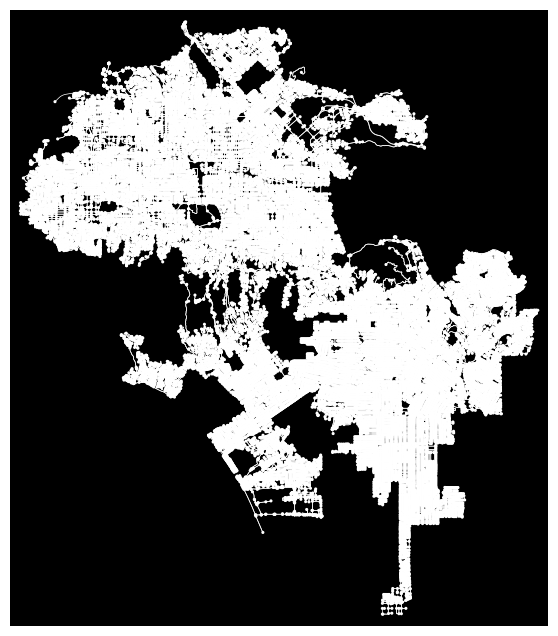

(<Figure size 800x800 with 1 Axes>, <Axes: >)

In [60]:
import osmnx as ox

# Define a smaller area or bounding box
city_name = 'Los Angeles, California, USA'

# Retrieve the graph with simplification and largest component only
G = ox.graph.graph_from_place(city_name, network_type='drive', simplify=True, retain_all=False)

# Optional: Plot the graph
ox.plot_graph(G, bgcolor='k', node_color='w', node_size=5, edge_color='w', edge_linewidth=0.5)


## Number of Parking Meters by Length per Street

The following map shows the number of parking meters by street segments in the city of Los Angeles with a focus on downtown LA area. Interestingly, even though we observe most of the parking meters by street in downtown, the segments with higher density seem to be dispersed across the area. In addition to downtown, other areas such as Hollywood, Beverly Hills, Culver City, and around Santa Monica. The closer they are from downtown LA, the more disperse they seem to be. There are also noticeable segments expanding northwest of the city of Los Angeles towards Calabasas and Burbank. Very few segments are present to the east and south of downtown LA.

In [61]:
# Filter out highways (e.g., motorways, trunk roads)
non_highway_edges = [(u, v, key) for u, v, key, data in G.edges(keys=True, data=True) if 'highway' not in data or 'highway' in data and data['highway'] != 'motorway']

# Create a new graph with non-highway streets
G = G.edge_subgraph(non_highway_edges)

# Plot the non-highway street network
#ox.plot_graph(G, bgcolor='k', node_color='w', edge_color='w', node_size=5, edge_linewidth=0.5)

In [62]:
# Step 1: Convert the graph to a GeoDataFrame containing edges
la_edges = ox.graph_to_gdfs(G, edges=True, nodes=False)

# Step 2: Project the graph to the EPSG:3857 coordinate reference system
G_projected = ox.project_graph(G, to_crs='EPSG:3857')

# Step 3: Extract longitude and latitude coordinates from the 'meters' GeoDataFrame
x_coords = meters['geometry'].x  # Longitude in meters
y_coords = meters['geometry'].y  # Latitude in meters

# Step 4: Find the nearest edges for each parking meter
nearest_edges = ox.distance.nearest_edges(G_projected, X=x_coords, Y=y_coords)

# Step 5: Create a DataFrame with edge identifiers and count occurrences
meters_nodes = pd.DataFrame(nearest_edges, columns=['u', 'v', 'key'])
meters_nodes['Count'] = 1

# Step 6: Group by edge identifiers and calculate total counts
grouped_counts = meters_nodes.groupby(['u', 'v'])['Count'].sum().reset_index()

# Step 7: Merge edge counts with the edges GeoDataFrame
merged_gdf = la_edges.merge(grouped_counts, on=['u', 'v'], how='left')

# Step 8: Filter rows with non-zero counts
merged_gdf = merged_gdf[merged_gdf['Count'] > 0]

# Step 9: Drop unnecessary columns for cleaner data
columns_to_remove = [
    'u', 'v', 'osmid', 'oneway', 'lanes', 'ref', 'maxspeed', 
    'reversed', 'access', 'bridge', 'junction', 'width', 'tunnel'
]
merged_gdf = merged_gdf.drop(columns=columns_to_remove)

# Step 10: Calculate the normalized count ('truecount')
merged_gdf['truecount'] = merged_gdf['Count'] / merged_gdf['length']

# Step 11: Filter out edges with lengths outside the range [10, 100]
length_filter = (merged_gdf['length'] >= 10) & (merged_gdf['length'] <= 100)
merged_gdf = merged_gdf[length_filter]

In [63]:
merged_gdf.explore(tiles='cartodbdark_matter', column = 'truecount')

## Parking Price in LA
Taking a closer look at the street parking prices in the city of Los Angeles, we observe the most expensive parking in downtown LA which can be as expensive as 6 times the price of adjacent areas. This makes total sense since downtown LA gathers the most high-income working-class commuters who demand parking the most, making the area most profitable. 

In [64]:
import pandas as pd
import folium
from folium.plugins import MarkerCluster
import xyzservices.providers

# Example data with RateRange added
data = {
    "SpaceID": ["WW516", "CB3034", "BH398"],
    "MeteredTimeLimit": ["2HR", "2HR", "1HR"],
    "RateRange": ["$1.00", "$1.00 - $6.00", "$1.00"],
    "LATITUDE": [34.060385, 34.047109, 34.045795],
    "LONGITUDE": [-118.304103, -118.245841, -118.21555],
}

# Convert to DataFrame
meters = pd.DataFrame(data)

# Convert MeteredTimeLimit to numeric hours (e.g., "2HR" -> 2)
meters['TimeLimit'] = meters['MeteredTimeLimit'].str.extract('(\d+)').astype(float)

# Convert RateRange to numeric (use midpoint for ranges)
def extract_rate(rate_range):
    rates = [float(r.replace("$", "")) for r in rate_range.split(" - ")]
    return sum(rates) / len(rates)  # Use midpoint

meters['RateValue'] = meters['RateRange'].apply(extract_rate)

# Create a map centered on Los Angeles with light mode
m = folium.Map(
    location=[34.05, -118.25],  # Center on Los Angeles
    zoom_start=12,
    tiles=xyzservices.providers.CartoDB.Positron  # Light mode tiles
)

# Add CircleMarkers to the map with size based on RateValue
for _, row in meters.iterrows():
    folium.CircleMarker(
        location=[row['LATITUDE'], row['LONGITUDE']],
        radius=row['RateValue'] * 5,  # Scale the size
        color="blue",
        fill=True,
        fill_opacity=0.6,
        popup=f"Metered Time Limit: {row['MeteredTimeLimit']}<br>Rate Range: {row['RateRange']}<br>Rate Value: ${row['RateValue']:.2f}"
    ).add_to(m)

# Display the map
m


In [65]:
# parking meters heated map
import folium
from folium.plugins import HeatMap
import pandas as pd

# Sample data as a DataFrame (replace with your actual data)
data = {
    "SpaceID": ["WW516", "CB3034", "BH398", "UC8", "CB2345"],
    "LATITUDE": [34.060385, 34.047109, 34.045795, 34.136733, 34.030958],
    "LONGITUDE": [-118.304103, -118.245841, -118.215550, -118.363025, -118.255362],
}
meters = pd.DataFrame(data)

# Extract coordinates for the heatmap
coordinates = meters[["LATITUDE", "LONGITUDE"]].values.tolist()

# Create a map centered on Los Angeles with a light mode basemap
m = folium.Map(location=[34.05, -118.25], zoom_start=12, tiles="CartoDB Positron")

# Add heatmap layer
HeatMap(coordinates).add_to(m)

# Display the map
m


In [66]:
import pandas as pd

# API URL for the CSV data
url = "https://data.lacity.org/resource/2nrs-mtv8.csv"

# Read the CSV file from the API
crime_data = pd.read_csv(url)

crime_data.head()

,dr_no,date_rptd,date_occ,time_occ,area,area_name,rpt_dist_no,part_1_2,crm_cd,crm_cd_desc,...,status,status_desc,crm_cd_1,crm_cd_2,crm_cd_3,crm_cd_4,location,cross_street,lat,lon
0,190326475,2020-03-01T00:00:00.000,2020-03-01T00:00:00.000,2130,7,Wilshire,784,1,510,VEHICLE - STOLEN,...,AA,Adult Arrest,510,998.0,NaN,NaN,1900 S LONGWOOD AV,NaN,34.0375,-118.3506
1,200106753,2020-02-09T00:00:00.000,2020-02-08T00:00:00.000,1800,1,Central,182,1,330,BURGLARY FROM VEHICLE,...,IC,Invest Cont,330,998.0,NaN,NaN,1000 S FLOWER ST,NaN,34.0444,-118.2628
2,200320258,2020-11-11T00:00:00.000,2020-11-04T00:00:00.000,1700,3,Southwest,356,1,480,BIKE - STOLEN,...,IC,Invest Cont,480,NaN,NaN,NaN,1400 W 37TH ST,NaN,34.0210,-118.3002
3,200907217,2023-05-10T00:00:00.000,2020-03-10T00:00:00.000,2037,9,Van Nuys,964,1,343,SHOPLIFTING-GRAND THEFT ($950.01 & OVER),...,IC,Invest Cont,343,NaN,NaN,NaN,14000 RIVERSIDE DR,NaN,34.1576,-118.4387
4,200412582,2020-09-09T00:00:00.000,2020-09-09T00:00:00.000,630,4,Hollenbeck,413,1,510,VEHICLE - STOLEN,...,IC,Invest Cont,510,NaN,NaN,NaN,200 E AVENUE 28,NaN,34.0820,-118.2130


## Vehicle Stolen Crimes Point
In this section, we will be analyzing car-related crimes in the city of Los Angeles, specifically examining vehicle stealing incidents. According to the 2020 crime data, most cars are stolen from central Los Angeles in addition to relatively smaller clusters around San Fernando and Long Beach.

In [67]:
# vehicle related crime map
import pandas as pd
import folium

# API URL for the CSV data
url = "https://data.lacity.org/resource/2nrs-mtv8.csv"

# Read the CSV file from the API
crime_data = pd.read_csv(url)

# Filter for "VEHICLE - STOLEN" cases
vehicle_stolen_data = crime_data[crime_data['crm_cd_desc'] == "VEHICLE - STOLEN"]

# Check for valid lat/lon data and drop rows with missing coordinates
vehicle_stolen_data = vehicle_stolen_data.dropna(subset=['lat', 'lon'])

# Convert lat/lon to numeric (in case they are read as strings)
vehicle_stolen_data['lat'] = pd.to_numeric(vehicle_stolen_data['lat'])
vehicle_stolen_data['lon'] = pd.to_numeric(vehicle_stolen_data['lon'])

# Create a map centered on Los Angeles with a light mode basemap
m = folium.Map(location=[34.05, -118.25], zoom_start=12, tiles="CartoDB Positron")

# Add markers for each "VEHICLE - STOLEN" case
for _, row in vehicle_stolen_data.iterrows():
    folium.Marker(
        location=[row['lat'], row['lon']],
        popup=f"Location: {row['location']}<br>Date: {row['date_occ']}"
    ).add_to(m)

# Display the map
m

## Vehicle Stolen Heat Map
This trend can be better represented by a heatmap that captures the location where a car was stolen. For the purpose of this study, we will be looking at the city of Los Angeles in particular. Shown by the map, the highest number of vehicles stolen incidents are located right around downtown LA and expands towards its surrounding neighborhoods such as Culver City, Inglewood, and parts of Pasadena. With downtown LA being the origin of the heat, it is reasonable for us to draw a conclusion that downtown LA demands the most attention and is considered the most dangerous when it comes to vehicle-related crimes.

In [68]:
import pandas as pd
import folium
from folium.plugins import HeatMap

# API URL for the CSV data
url = "https://data.lacity.org/resource/2nrs-mtv8.csv"

# Read the CSV file from the API
crime_data = pd.read_csv(url)

# Filter for "VEHICLE - STOLEN" cases
vehicle_stolen_data = crime_data[crime_data['crm_cd_desc'] == "VEHICLE - STOLEN"]

# Drop rows with missing coordinates
vehicle_stolen_data = vehicle_stolen_data.dropna(subset=['lat', 'lon'])

# Convert lat/lon to numeric
vehicle_stolen_data['lat'] = pd.to_numeric(vehicle_stolen_data['lat'])
vehicle_stolen_data['lon'] = pd.to_numeric(vehicle_stolen_data['lon'])

# Extract latitude and longitude as a list of [lat, lon]
heat_data = vehicle_stolen_data[['lat', 'lon']].values.tolist()

# Create a map centered on Los Angeles with a light mode basemap
m = folium.Map(location=[34.05, -118.25], zoom_start=12, tiles="CartoDB Positron")

# Add the heatmap layer
HeatMap(heat_data, radius=10).add_to(m)

# Display the map
m

In [69]:
# Import packages

import altair as alt
import geopandas as gpd
import pandas as pd
import numpy as np
import hvplot.pandas
import pandas as pd
#import seaborn as sns
from matplotlib import pyplot as plt
import holoviews as hv
from shapely.geometry import Polygon
from shapely.geometry import MultiPolygon
import requests
import geoviews as gv
import geoviews.tile_sources as gvts
import folium
from folium import plugins
from shapely.geometry import Point
import xyzservices
import osmnx as ox
import networkx as nx
import pygris
import cenpy



%matplotlib inline

# See lots of columns
pd.options.display.max_rows = 9999 
pd.options.display.max_colwidth = 200

# Hide warnings due to issue in shapely package 
# See: https://github.com/shapely/shapely/issues/1345
np.seterr(invalid="ignore");

In [70]:
available = cenpy.explorer.available()
available.head()

# Return a dataframe of

/Users/bin/miniforge3/envs/musa-550-fall-2023/lib/python3.10/site-packages/cenpy/explorer.py:70: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  listcols = raw_table.applymap(lambda x: isinstance(x, list)).any()


,c_isTimeseries,c_isMicrodata,publisher,temporal,spatial,programCode,modified,keyword,contactPoint,distribution,description,bureauCode,accessLevel,title,c_isAvailable,c_isCube,c_isAggregate,c_dataset,vintage
ABSCB2017,NaN,NaN,U.S. Census Bureau,2017/2017,United States,006:007,2020-04-30 00:00:00.0,"(census,)","{'fn': 'ABS Staff', 'hasEmail': 'mailto:adep.annual.business.survey@census.gov'}","{'@type': 'dcat:Distribution', 'accessURL': 'http://api.census.gov/data/2017/abscb', 'description': 'API endpoint', 'format': 'API', 'mediaType': 'application/json', 'title': 'API endpoint'}","The Annual Business Survey (ABS) provides information on selected economic and demographic characteristics for businesses and business owners by sex, ethnicity, race, and veteran status. Further, ...",006:07,public,Annual Business Survey: Characteristics of Businesses: 2017,True,NaN,True,"(abscb,)",2017.0
ABSCB2018,NaN,NaN,U.S. Census Bureau,2018/2018,United States,006:007,2020-10-26 00:00:00.0,"(census,)","{'fn': 'ABS Staff', 'hasEmail': 'mailto:adep.annual.business.survey@census.gov'}","{'@type': 'dcat:Distribution', 'accessURL': 'http://api.census.gov/data/2018/abscb', 'description': 'API endpoint', 'format': 'API', 'mediaType': 'application/json', 'title': 'API endpoint'}","The Annual Business Survey (ABS) provides information on selected economic and demographic characteristics for businesses and business owners by sex, ethnicity, race, and veteran status. Further, ...",006:07,public,Annual Business Survey: Characteristics of Businesses: 2018,True,NaN,True,"(abscb,)",2018.0
ABSCB2019,NaN,NaN,U.S. Census Bureau,2019/2019,US,006:007,2021-08-17 00:00:00.0,"(census,)","{'fn': 'ASE Staff', 'hasEmail': 'mailto:ERD.annual.survey.of.entrepreneurs@census.gov'}","{'@type': 'dcat:Distribution', 'accessURL': 'http://api.census.gov/data/2019/abscb', 'description': 'API endpoint', 'format': 'API', 'mediaType': 'application/json', 'title': 'API endpoint'}","The Annual Business Survey (ABS) provides information on selected economic and demographic characteristics for businesses and business owners by sex, ethnicity, race, and veteran status. Further, ...",006:07,public,2019 Annual Business Survey: Characteristics of Business,True,NaN,True,"(abscb,)",2019.0
ABSCB2020,NaN,NaN,U.S. Census Bureau,2020/2020,US,006:007,2022-08-03 00:00:00.0,"(census,)","{'fn': 'ASE Staff', 'hasEmail': 'mailto:ERD.annual.survey.of.entrepreneurs@census.gov'}","{'@type': 'dcat:Distribution', 'accessURL': 'http://api.census.gov/data/2020/abscb', 'description': 'API endpoint', 'format': 'API', 'mediaType': 'application/json', 'title': 'API endpoint'}","The Annual Business Survey (ABS) provides information on selected economic and demographic characteristics for businesses and business owners by sex, ethnicity, race, and veteran status. Further, ...",006:07,public,2020 Annual Business Survey: Characteristics of Business,True,NaN,True,"(abscb,)",2020.0
ABSCB2021,NaN,NaN,U.S. Census Bureau,2021/2021,United States,006:007,2023-07-24 10:30:52.0,"(census,)","{'fn': 'ABS Staff', 'hasEmail': 'mailto:adep.annual.business.survey@census.gov'}","{'@type': 'dcat:Distribution', 'accessURL': 'http://api.census.gov/data/2021/abscb', 'description': 'API endpoint', 'format': 'API', 'mediaType': 'application/json', 'title': 'API endpoint'}","The Annual Business Survey (ABS) provides information on selected economic and demographic characteristics for businesses and business owners by sex, ethnicity, race, and veteran status. Further, ...",006:07,public,2021 Annual Business Survey: Characteristics of Business,True,NaN,True,"(abscb,)",2021.0


In [71]:
# Connect to Census API
acs = cenpy.remote.APIConnection("ACSDT5Y2021")

# Define variables of interest
variables = [
    "NAME",
    "B19013_001E",  # Median income
    "B03002_001E",  # Total population
    "B03002_003E",  # Not Hispanic, White
    "B03002_012E",  # Hispanic or Latino
    "B08301_001E",  # Means of transportation to work
    "B08301_010E"   # Public transportation
]

# Los Angeles County and California codes
la_county_code = "037"
ca_state_code = "06"

# Query ACS data for Los Angeles block groups
la_inc_data = acs.query(
    cols=variables,
    geo_unit="block group:*",
    geo_filter={"state": ca_state_code, "county": la_county_code, "tract": "*"}
)

# Convert numerical columns to float
for variable in variables:
    if variable != "NAME":
        la_inc_data[variable] = la_inc_data[variable].astype(float)

In [72]:
# Create a cleaned DataFrame from la_inc_data
la_final = la_inc_data.copy()

# Adjusted columns to drop
columns_to_drop = [
    "STATEFP", "COUNTYFP", "TRACTCE", "BLKGRPCE", "GEOID", "NAMELSAD",
    "MTFCC", "FUNCSTAT", "ALAND", "AWATER", "INTPTLAT", "INTPTLON"
]

# Drop unnecessary columns
if all(col in la_final.columns for col in columns_to_drop):
    la_final.drop(columns=columns_to_drop, inplace=True)
else:
    missing_cols = [col for col in columns_to_drop if col not in la_final.columns]
    print(f"Warning: The following columns are missing and cannot be dropped: {missing_cols}")

# Verify the structure of the cleaned DataFrame
print(la_final.columns)
la_final.head()


Index(['NAME', 'B19013_001E', 'B03002_001E', 'B03002_003E', 'B03002_012E',
       'B08301_001E', 'B08301_010E', 'state', 'county', 'tract',
       'block group'],
      dtype='object')


,NAME,B19013_001E,B03002_001E,B03002_003E,B03002_012E,B08301_001E,B08301_010E,state,county,tract,block group
0,"Block Group 1, Census Tract 1011.10, Los Angeles County, California",63242.0,1630.0,932.0,571.0,697.0,13.0,06,037,101110,1
1,"Block Group 2, Census Tract 1011.10, Los Angeles County, California",56250.0,1492.0,864.0,314.0,772.0,47.0,06,037,101110,2
2,"Block Group 3, Census Tract 1011.10, Los Angeles County, California",99567.0,757.0,509.0,120.0,468.0,0.0,06,037,101110,3
3,"Block Group 1, Census Tract 1011.22, Los Angeles County, California",120833.0,2608.0,1879.0,117.0,1195.0,0.0,06,037,101122,1
4,"Block Group 2, Census Tract 1011.22, Los Angeles County, California",90536.0,1639.0,1061.0,222.0,782.0,9.0,06,037,101122,2


In [73]:
# Rename columns for easier interpretation
la_final.rename(columns={
    "B19013_001E": "Median Income",
    "B03002_001E": "Total Population",
    "B03002_003E": "White Population",
    "B03002_012E": "Hispanic Population",
    "B08301_001E": "Total Commuters",
    "B08301_010E": "Public Transit Commuters"
}, inplace=True)


In [74]:
import geopandas as gpd
import pygris

# Step 1: Import block group geometries
block_groups = pygris.block_groups(state="CA", county="037", year=2021)

# Step 2: Rename columns in block_groups to match la_final
block_groups.rename(
    columns={
        "STATEFP": "state",
        "COUNTYFP": "county",
        "TRACTCE": "tract",
        "BLKGRPCE": "block group"
    },
    inplace=True
)

# Step 3: Merge with your dataset
la_final_geo = block_groups.merge(la_final, on=["state", "county", "tract", "block group"], how="left")

# Step 4: Set the CRS
la_final_geo.crs = "EPSG:4326"

# Step 5: Visualize Median Income
la_final_geo.explore(
    column="Median Income",
    tiles="cartodbdark_matter",
    legend=True
)


Using FIPS code '06' for input 'CA'


In [75]:
import geopandas as gpd
from shapely.geometry import Point

# Check if the necessary columns exist
if 'lat' in crime_data.columns and 'lon' in crime_data.columns:
    # Create geometry from latitude and longitude
    crime_data['geometry'] = gpd.points_from_xy(crime_data['lon'], crime_data['lat'])
    
    # Convert to GeoDataFrame
    crime_gdf = gpd.GeoDataFrame(crime_data, geometry='geometry', crs="EPSG:4326")
    
    # Check the first few rows to confirm
    print(crime_gdf.head())
else:
    print("Latitude ('lat') or Longitude ('lon') columns are missing in the dataset.")


       dr_no                date_rptd                 date_occ  time_occ  \
0  190326475  2020-03-01T00:00:00.000  2020-03-01T00:00:00.000      2130   
1  200106753  2020-02-09T00:00:00.000  2020-02-08T00:00:00.000      1800   
2  200320258  2020-11-11T00:00:00.000  2020-11-04T00:00:00.000      1700   
3  200907217  2023-05-10T00:00:00.000  2020-03-10T00:00:00.000      2037   
4  200412582  2020-09-09T00:00:00.000  2020-09-09T00:00:00.000       630   

   area   area_name  rpt_dist_no  part_1_2  crm_cd  \
0     7    Wilshire          784         1     510   
1     1     Central          182         1     330   
2     3   Southwest          356         1     480   
3     9    Van Nuys          964         1     343   
4     4  Hollenbeck          413         1     510   

                                crm_cd_desc  ...   status_desc  crm_cd_1  \
0                          VEHICLE - STOLEN  ...  Adult Arrest       510   
1                     BURGLARY FROM VEHICLE  ...   Invest Cont    

import geopandas as gpd
from shapely.geometry import Point, Polygon

# Define the LA bounding box
la_bbox = gpd.GeoDataFrame(
    {'geometry': [Polygon([
        (-118.6682, 33.7045),  # Southwest corner
        (-118.1553, 33.7045),  # Southeast corner
        (-118.1553, 34.3373),  # Northeast corner
        (-118.6682, 34.3373),  # Northwest corner
        (-118.6682, 33.7045)   # Close polygon
    ])]},
    crs="EPSG:4326"
)

# Ensure `meters` contains the necessary latitude and longitude data
if 'LATITUDE' in meters.columns and 'LONGITUDE' in meters.columns:
    # Create a GeoDataFrame for meters
    meters['geometry'] = gpd.points_from_xy(meters['LONGITUDE'], meters['LATITUDE'])
    meters_gdf = gpd.GeoDataFrame(meters, geometry='geometry', crs="EPSG:4326")
else:
    raise ValueError("Meters dataset must have 'LATITUDE' and 'LONGITUDE' columns.")

# Filter crime data within the bounding box
crime_gdf = crime_gdf[crime_gdf.intersects(la_bbox.unary_union)]

# Filter meters data within the bounding box
meters_gdf = meters_gdf[meters_gdf.intersects(la_bbox.unary_union)]

# Verify the results
print("Filtered Crime Data:")
print(crime_gdf.head())

print("Filtered Meters Data:")
print(meters_gdf.head())


In [78]:
import geopandas as gpd
from shapely.geometry import box

# Step 1: Define the bounding box for Los Angeles
la_bbox = box(-118.6682, 33.7045, -118.1553, 34.3373)  # Define bounds (xmin, ymin, xmax, ymax)
la_bbox_gdf = gpd.GeoDataFrame({'geometry': [la_bbox]}, crs="EPSG:4326")

# Step 2: Generate a grid over the bounding box
grid_size = 0.01  # Adjust this value to change grid cell size (in degrees for EPSG:4326)
minx, miny, maxx, maxy = la_bbox.bounds
grid_cells = []
x = minx
while x < maxx:
    y = miny
    while y < maxy:
        grid_cells.append(box(x, y, x + grid_size, y + grid_size))
        y += grid_size
    x += grid_size

# Create a GeoDataFrame for the grid
grid = gpd.GeoDataFrame({'geometry': grid_cells}, crs="EPSG:4326")

# Step 3: Perform spatial join with the crime GeoDataFrame
grid_with_crimes = gpd.sjoin(grid, crime_gdf, how="left", predicate="intersects")

# Step 4: Count crimes in each grid cell
crime_counts = grid_with_crimes.groupby(grid_with_crimes.index).size()

# Step 5: Add crime counts back to the grid
grid['crime_count'] = grid.index.map(crime_counts).fillna(0)

# Step 6: Visualize or analyze the grid with crime counts
print(grid.head())
grid.explore(column='crime_count', legend=True)


                                                                                                              geometry  \
0  POLYGON ((-118.65820 33.70450, -118.65820 33.71450, -118.66820 33.71450, -118.66820 33.70450, -118.65820 33.70450))   
1  POLYGON ((-118.65820 33.71450, -118.65820 33.72450, -118.66820 33.72450, -118.66820 33.71450, -118.65820 33.71450))   
2  POLYGON ((-118.65820 33.72450, -118.65820 33.73450, -118.66820 33.73450, -118.66820 33.72450, -118.65820 33.72450))   
3  POLYGON ((-118.65820 33.73450, -118.65820 33.74450, -118.66820 33.74450, -118.66820 33.73450, -118.65820 33.73450))   
4  POLYGON ((-118.65820 33.74450, -118.65820 33.75450, -118.66820 33.75450, -118.66820 33.74450, -118.65820 33.74450))   

   crime_count  
0            1  
1            1  
2            1  
3            1  
4            1  


In [79]:
# Perform spatial join to associate parking meters with grid cells
grid_with_meters = gpd.sjoin(grid, meters_gdf, how="left", op="intersects")

# Count parking meters in each grid cell
meter_counts = grid_with_meters.groupby(grid_with_meters.index).size()

# Add meter counts back to the grid
grid['meter_count'] = grid.index.map(meter_counts).fillna(0)


/Users/bin/miniforge3/envs/musa-550-fall-2023/lib/python3.10/site-packages/IPython/core/interactiveshell.py:3448: FutureWarning: The `op` parameter is deprecated and will be removed in a future release. Please use the `predicate` parameter instead.
  if await self.run_code(code, result, async_=asy):


In [84]:
# Normalize scores
grid['crime_score'] = grid['crime_count'] / grid['crime_count'].max()
grid['meter_score'] = grid['meter_count'] / grid['meter_count'].max()

# Assign weights
crime_weight = 0.8
meter_weight = 0.2

# Calculate composite score
grid['recommendation_score'] = grid['meter_score'] * meter_weight - grid['crime_score'] * crime_weight


In [85]:
# Visualize the recommendation score
grid.explore(
    column='recommendation_score',
    cmap='RdYlGn',  # Green for high scores, red for low scores
    legend=True,
    legend_kwds={'caption': 'Parking Recommendation Score'}
)

# Save results
grid.to_file('./data/recommended_parking.geojson', driver='GeoJSON')


In [86]:
print(grid.columns)
grid = grid.reset_index()
print(grid.columns)  # Confirm 'index' is now a column

Index(['index', 'geometry', 'crime_count', 'meter_count', 'crime_score',
       'meter_score', 'recommendation_score'],
      dtype='object')
Index(['level_0', 'index', 'geometry', 'crime_count', 'meter_count',
       'crime_score', 'meter_score', 'recommendation_score'],
      dtype='object')


## Parking Recommendation Score Map
Combing the results from the previous sections, we attempted to create a map that takes consideration of both affordability and safety of parking in area with the highest risks which is downtown LA. This map provides drivers with the need for street parking in downtown LA with parking recommendation scores in the area. A lower score, marks by the red color, means that it is likely that the area is considered both dangerous and expensive for street parking while a higher score, marks by the green color, suggest that the area is likely to be more preferable for parking.

In [92]:
import folium

# Initialize the folium map with light tiles, centered on Downtown LA
m = folium.Map(location=[34.0407, -118.2468], zoom_start=12, tiles='cartodbpositron')

# Add a Choropleth layer for recommendation scores
folium.Choropleth(
    geo_data=grid,  # GeoDataFrame with grid and recommendation score
    data=grid,  # Data for the Choropleth
    columns=['index', 'recommendation_score'],  # Columns to use: 'index' and score
    key_on='feature.properties.index',  # Match GeoJSON 'index' with data 'index'
    fill_color='RdYlGn',  # Green for high scores, red for low scores
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name='Parking Recommendation Score'
).add_to(m)

# Display the map in the notebook
m
